In [1]:
import zarr
import xarray as xr
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from global_land_mask import globe
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib as mpl
import scipy

from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from IPython.display import Image

mpl.rcParams['figure.dpi']= 150
plt.rcParams.update({'font.size': 8})
mpl.rcParams['axes.linewidth'] = 0.3
g = 9.80616 #Avg. gravity acceleration on Earth

In [2]:
from dask.distributed import Client, LocalCluster
cluster = LocalCluster()
client = Client(cluster)
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 11
Total threads: 11,Total memory: 18.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:63382,Workers: 11
Dashboard: http://127.0.0.1:8787/status,Total threads: 11
Started: Just now,Total memory: 18.00 GiB
Comm: tcp://127.0.0.1:63417,Total threads: 1
Dashboard: http://127.0.0.1:63428/status,Memory: 1.64 GiB
Nanny: tcp://127.0.0.1:63385,


In [6]:
import multiprocessing as mp

In [7]:
print(f"Number of CPU cores available: {mp.cpu_count()}")

Number of CPU cores available: 11


In [2]:
ds = xr.open_zarr(
    'gs://gcp-public-data-arco-era5/ar/full_37-1h-0p25deg-chunk-1.zarr-v3',
    consolidated=True,
    storage_options={'token': 'anon'}
)

In [56]:
# Weatherbench 6-hr fields (use this for longer days
ds = xr.open_zarr(
    'gs://weatherbench2/datasets/era5/1959-2023_01_10-wb13-6h-1440x721_with_derived_variables.zarr',
    consolidated=True,
    storage_options={'token': 'anon'}
)

In [3]:
# Gulf
lat1, lat2 = 45, 10
lon1, lon2 = 250, 300

# Texas
#lat1, lat2 = 37, 25.5
#lon1, lon2 = 253, 270

# For western US
#lat1, lat2 = 55, 15
#lon1, lon2 = 200, 250

In [4]:
# Gulf case: 2024 01 24 00
# Case 2: 2025 02 15 00

In [5]:
ds_sel = ds.sel(time=slice('2025-07-02', '2025-07-05'), latitude=slice(lat1,lat2), longitude=slice(lon1,lon2))

In [6]:
qu = ds_sel.specific_humidity*ds_sel.u_component_of_wind
qv = ds_sel.specific_humidity*ds_sel.v_component_of_wind

In [7]:
qu_int = 100*qu.integrate('level')/g
qv_int = 100*qv.integrate('level')/g

In [8]:
IVT = np.sqrt(qu_int**2 + qv_int**2)

In [9]:
variable = IVT # variable for which the animation is created

In [10]:
ds850 = ds_sel.sel(level=850, longitude=slice(None, None, 8), latitude=slice(None, None, 8))

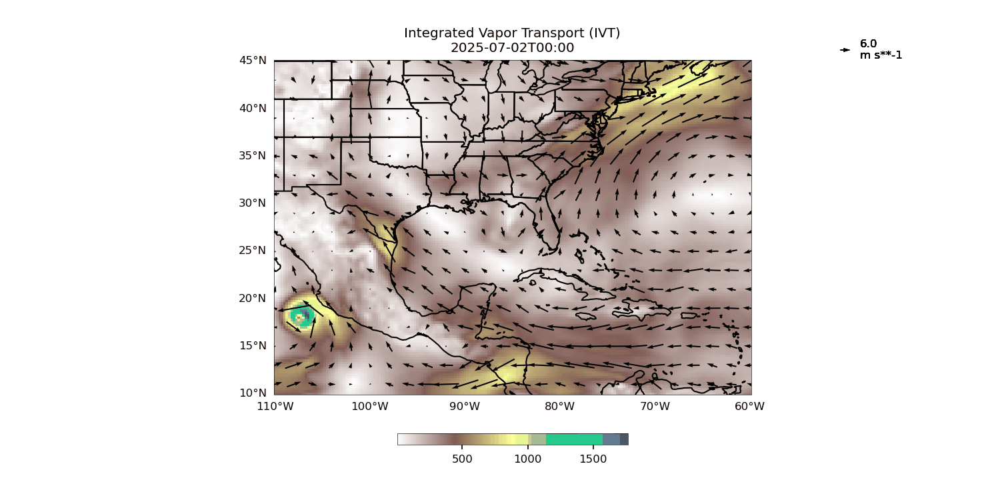

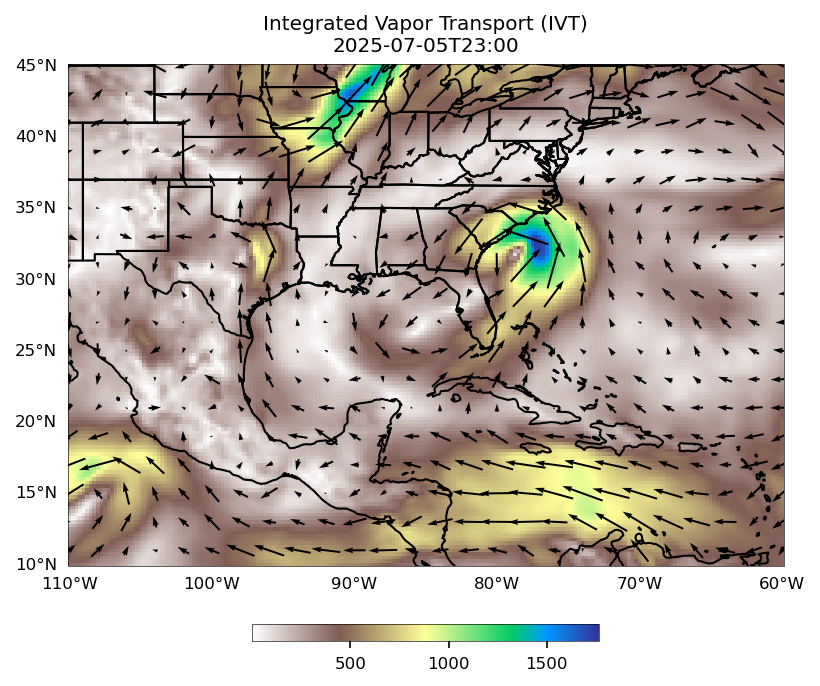

In [ ]:
# Setup plot
fig, ax = plt.subplots(figsize=(5, 4), subplot_kw={'projection': ccrs.PlateCarree()})
ax.coastlines()
ax.add_feature(cfeature.STATES, edgecolor='black', zorder=10)

gls = ax.gridlines(draw_labels=True, color='none')
gls.top_labels = False
gls.right_labels = False

# Initial frame
# Store the collection created by the initial plot
current_plot = variable.isel(time=0).plot(
    ax=ax,
    transform=ccrs.PlateCarree(),
    cmap='terrain_r',
    add_colorbar=True,
    cbar_kwargs={'fraction': 0.03, 'orientation': 'horizontal', 'pad': 0.1}
)
ds850.isel(time=0).plot.quiver("longitude", "latitude", "u_component_of_wind", "v_component_of_wind", ax=ax)

# Title
title = ax.set_title(f"Integrated Vapor Transport (IVT)\n{str(variable.time.values[0])[:16]}")

# Update function
def update(frame):
    # We don't need to explicitly remove collections for blitting.
    # The new artists we return will overwrite the old ones in the blit process.
    # Instead of assigning to current_plot and trying to remove collections,
    # we just plot the new frame directly.

    # Plot the new frame and get the artist (GeoQuadMesh) returned by plot
    new_plot = variable.isel(time=frame).plot(
        ax=ax,
        transform=ccrs.PlateCarree(),
        cmap='terrain_r',
        add_colorbar=False
    )
    ds850.isel(time=frame).plot.quiver("longitude", "latitude", "u_component_of_wind", "v_component_of_wind", ax=ax)
    title.set_text(f"Integrated Vapor Transport (IVT)\n{str(variable.time.values[frame])[:16]}")

    # Return the artists that need to be redrawn: the new plot and the title
    return new_plot, title

# Create animation
# With blit=True, the update function should return the artists that have changed.
# These artists will be redrawn on top of the static background.
anim = FuncAnimation(fig, update, frames=len(variable.time), interval=500, blit=True)
anim.save("IVT_animation.gif", writer="pillow", fps=2)

Image(filename="IVT_animation.gif")